# Explore YOLO and SAM

In [1]:
from ultralytics import YOLO
import os
import torch
from PIL import Image
# EXAMPLE: https://github.com/ultralytics/ultralytics
os.chdir("..")
ROOT = os.getcwd()
DIR_DATA = os.path.join(ROOT, "data")
PATH_IMG = os.path.join(DIR_DATA, "raw", "fire_ant_activity", "A1", "A1_1.JPEG")
print("ROOT:", ROOT)

ROOT: /Users/niche/Library/CloudStorage/OneDrive-VirginiaTech/_03_Papers/2023/finding_ants


W, H: 1636 2180


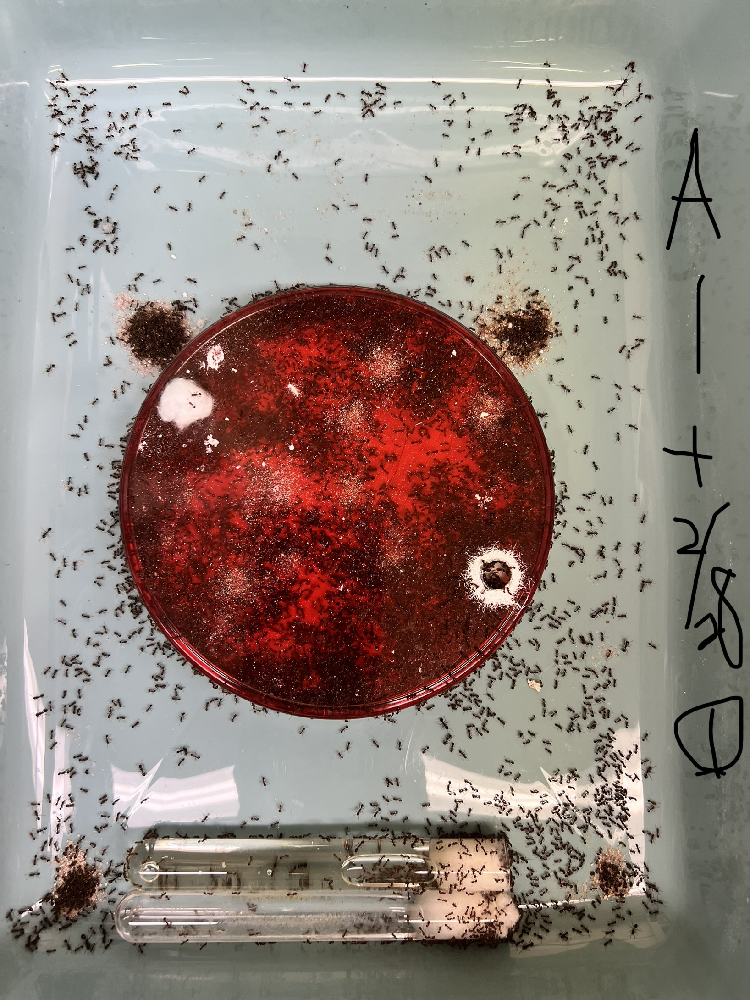

In [7]:
# load image
img = Image.open(PATH_IMG)
W, H = img.size
img

In [22]:
RATE = 8
SIZE_YOLO = 640
sw = int(W / RATE)
sh = int(H / RATE)
# show cropped image of size (sw, sh)
imgs = []
for i in range(RATE):
    for j in range(RATE):
        imgs.append(img.crop((i * sw,
                              j * sh,
                              (i + 1) * sw,
                              (j + 1) * sh)).resize((SIZE_YOLO, SIZE_YOLO)))

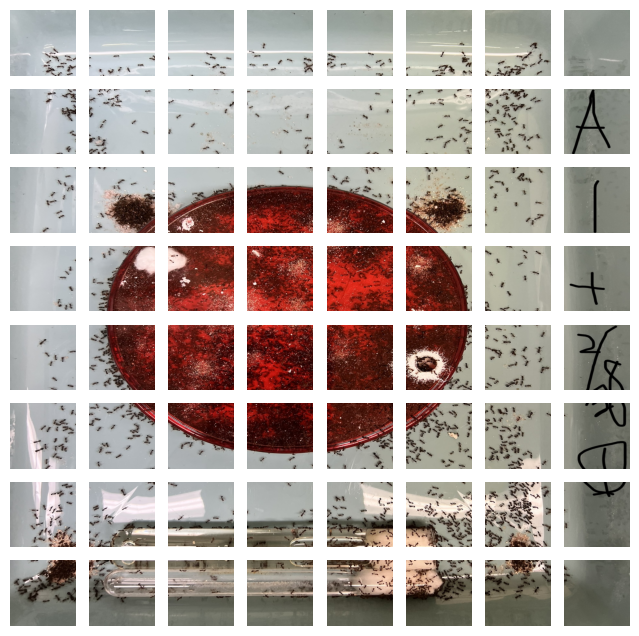

In [24]:
# diaplay cropped images
import matplotlib.pyplot as plt

fig, axes = plt.subplots(RATE, RATE, figsize=(RATE, RATE))
for i in range(RATE):
    for j in range(RATE):
        axes[j, i].imshow(imgs[i * RATE + j])
        axes[j, i].axis("off")

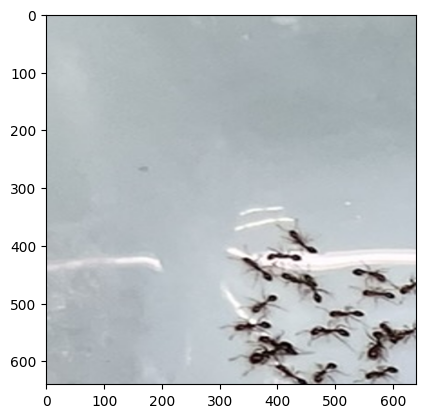

In [31]:
plt.imshow(imgs[0])

## YOLOv8

In [133]:
# Load a model
# load a pretrained model (recommended for training)
model = YOLO(os.path.join(ROOT, "models", "yolov8m.pt"))

In [149]:
results = model.predict(imgs)


0: 640x640 (no detections), 1: 640x640 3 birds, 2 kites, 2: 640x640 4 birds, 3: 640x640 4 birds, 1 kite, 4: 640x640 5 birds, 3 kites, 5: 640x640 1 bird, 6: 640x640 1 kite, 7: 640x640 (no detections), 8: 640x640 2 birds, 9: 640x640 4 birds, 1 kite, 10: 640x640 2 birds, 1 cake, 11: 640x640 1 bird, 12: 640x640 (no detections), 13: 640x640 3 birds, 1 fork, 14: 640x640 5 birds, 15: 640x640 (no detections), 16: 640x640 2 birds, 17: 640x640 3 kites, 18: 640x640 1 person, 1 bird, 1 kite, 19: 640x640 (no detections), 20: 640x640 (no detections), 21: 640x640 (no detections), 22: 640x640 6 kites, 23: 640x640 1 bird, 24: 640x640 6 birds, 2 kites, 25: 640x640 1 person, 5 birds, 26: 640x640 (no detections), 27: 640x640 (no detections), 28: 640x640 (no detections), 29: 640x640 (no detections), 30: 640x640 1 bird, 1 kite, 31: 640x640 1 person, 32: 640x640 8 birds, 33: 640x640 1 bird, 3 kites, 34: 640x640 1 bird, 35: 640x640 (no detections), 36: 640x640 (no detections), 37: 640x640 1 skis, 38: 640x640

In [290]:
results

[ultralytics.yolo.engine.results.Results object with attributes:
 
 boxes: ultralytics.yolo.engine.results.Boxes object
 keypoints: None
 keys: ['boxes']
 masks: None
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair',

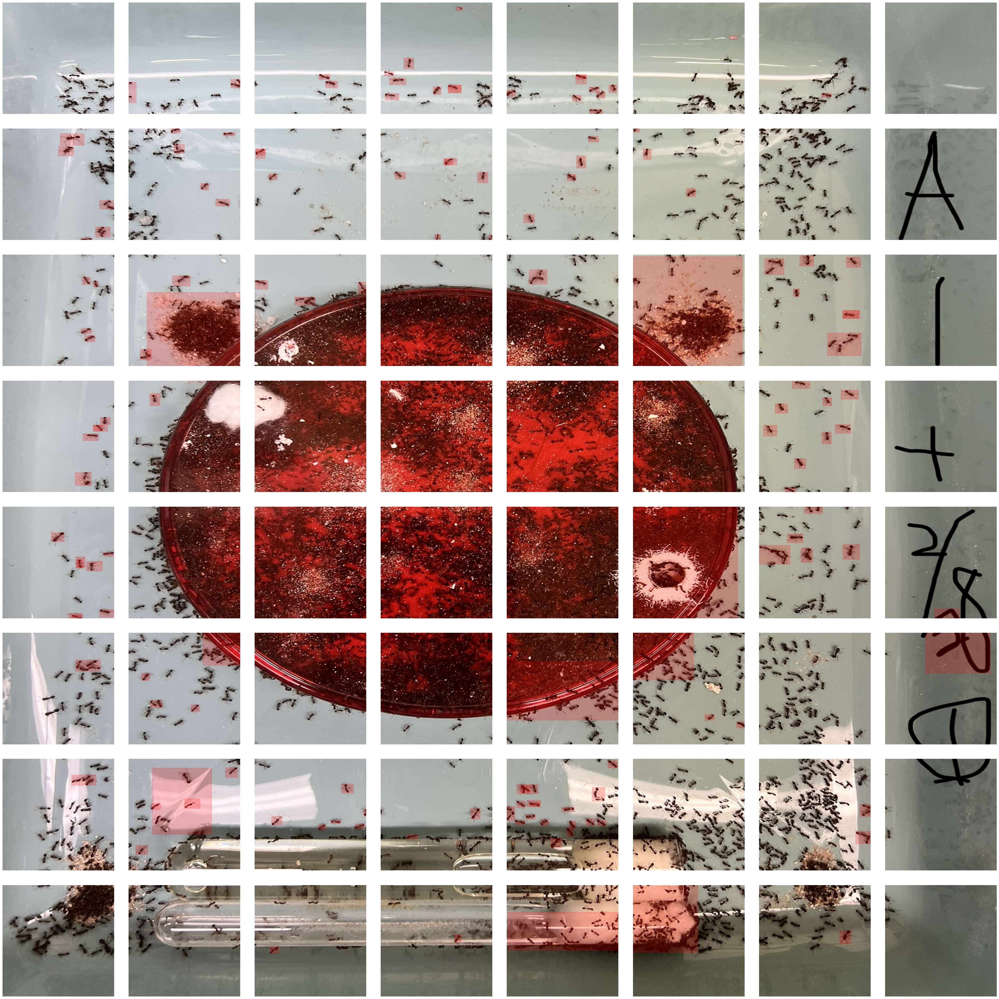

In [173]:
# show bounding boxes
import seaborn as sns

# 8 * 8 subplots
fig, axes = plt.subplots(RATE, RATE, figsize=(RATE*5, RATE*5))
# tight layout
plt.tight_layout()
for i in range(RATE):
    for j in range(RATE):
        axes[j, i].imshow(imgs[i * RATE + j])
        axes[j, i].axis("off")
        for result in results[i * RATE + j]:
            # send to cpu
            for box in np.array(result.boxes.xyxy.cpu()):
                x1, y1, x2, y2 = box
                w, h = x2 - x1, y2 - y1
                axes[j, i].add_patch(Rectangle((x1, y1), w, h,
                                                linewidth=1,
                                                edgecolor='r',
                                                facecolor='r',
                                                alpha=.2))


In [165]:
# list all bbox in xyxy format
bbxs = []
for result in results:
    for box in np.array(result.boxes.xyxy.cpu()):
        bbxs.append(box)

# compute area
def compute_area(xyxy):
    x1, y1, x2, y2 = xyxy
    return (x2 - x1) * (y2 - y1)

# compute area of each bbox
areas = [compute_area(xyxy) for xyxy in bbxs]
thred = np.quantile(areas, .8)
thred

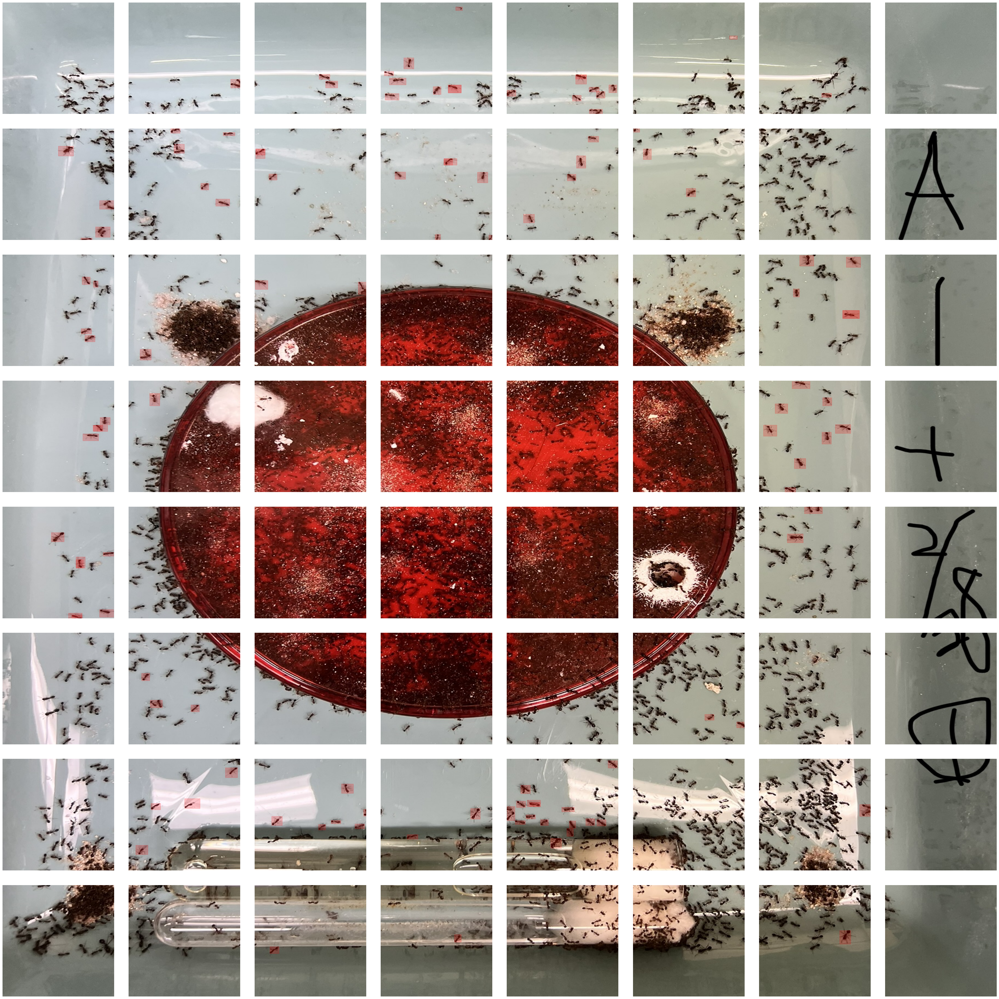

In [172]:
# patch
from matplotlib.patches import Rectangle
# 8 * 8 subplots
fig, axes = plt.subplots(RATE, RATE, figsize=(RATE*5, RATE*5))
# tight layout
plt.tight_layout()
for i in range(RATE):
    for j in range(RATE):
        axes[j, i].imshow(imgs[i * RATE + j])
        axes[j, i].axis("off")
        for result in results[i * RATE + j]:
            # send to cpu
            for box in np.array(result.boxes.xyxy.cpu()):
                if compute_area(box) < thred:
                    x1, y1, x2, y2 = box
                    w, h = x2 - x1, y2 - y1
                    axes[j, i].add_patch(Rectangle((x1, y1), w, h,
                                                   linewidth=1,
                                                   edgecolor='r',
                                                   facecolor='r',
                                                   alpha=.2))


In [198]:
ls_out = [{
    "img" : result.orig_img,
    "bbox" : [box for box in np.array(result.boxes.xyxy.cpu()) if compute_area(box) < thred]
} for result in results]

In [201]:
ls_out[1]

{'img': array([[[185, 182, 174],
         [185, 182, 174],
         [185, 182, 174],
         ...,
         [216, 208, 201],
         [216, 209, 202],
         [216, 209, 202]],
 
        [[185, 182, 174],
         [185, 182, 174],
         [185, 182, 174],
         ...,
         [214, 208, 201],
         [214, 209, 202],
         [214, 209, 202]],
 
        [[188, 185, 177],
         [188, 185, 177],
         [188, 185, 177],
         ...,
         [212, 207, 200],
         [212, 207, 201],
         [212, 207, 201]],
 
        ...,
 
        [[168, 166, 158],
         [168, 166, 158],
         [168, 166, 158],
         ...,
         [143, 146, 143],
         [136, 140, 136],
         [133, 137, 133]],
 
        [[164, 162, 154],
         [164, 162, 154],
         [164, 162, 154],
         ...,
         [125, 128, 125],
         [116, 119, 117],
         [112, 115, 113]],
 
        [[162, 160, 152],
         [162, 160, 152],
         [162, 160, 152],
         ...,
         [117, 120, 1

In [203]:
# crop out bbox
imgs_crop = []
for out in ls_out:
    # convert to PIL image
    img = Image.fromarray(out["img"])
    for box in out["bbox"]:
        x1, y1, x2, y2 = box
        imgs_crop.append(img.crop((x1, y1, x2, y2)))


In [212]:
len(imgs_crop)

116

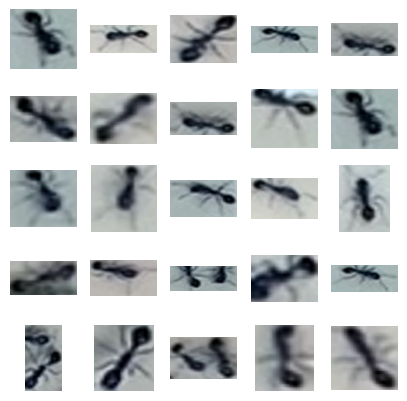

In [221]:
# sample cropped images
import random
SIZE = 5
fig, axes = plt.subplots(SIZE, SIZE, figsize=(SIZE, SIZE))
for i in range(SIZE):
    for j in range(SIZE):
        img_rdm = random.choice(imgs_crop)
        axes[j, i].imshow(img_rdm)
        axes[j, i].axis("off")

## SAM

### SAM with bbox

In [250]:
# SAM
import torch
import supervision as sv
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
SAM_CHECKPOINT_PATH = os.path.join(ROOT, "models", "sam_vit_h_4b8939.pth")
SAM_ENCODER_VERSION = "vit_h"
DEVICE = torch.device('cpu')
sam = sam_model_registry[SAM_ENCODER_VERSION](checkpoint=SAM_CHECKPOINT_PATH).to(device=DEVICE)
sam_predictor = SamPredictor(sam)

[     558.95      209.81      617.41      252.26]
[     517.63      254.89       573.4      289.18]
[     520.88      255.11      602.16      289.71]
[     459.92      304.21      550.94      343.49]


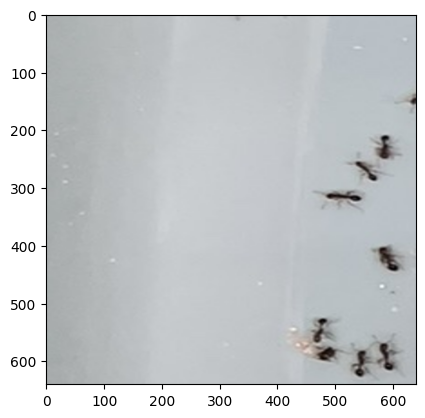

In [280]:
# convert detections to masks
out = ls_out[3]
image = out["img"]
# load as cv2 image
image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
bbox = out["bbox"]
plt.imshow(image)
for box in bbox:
    print(box)

In [251]:
def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
    sam_predictor.set_image(image)
    result_masks = []
    for box in xyxy:
        masks, scores, logits = sam_predictor.predict(
            box=box[None, :],
            multimask_output=True
        )
        index = np.argmax(scores)
        result_masks.append(masks[index])
    return np.array(result_masks)

sam_result = segment(
    sam_predictor=sam_predictor,
    image=image,
    xyxy=bbox
)

In [282]:
print(image.shape)
np.array(bbox)

(640, 640, 3)


array([[     558.95,      209.81,      617.41,      252.26],
       [     517.63,      254.89,       573.4,      289.18],
       [     520.88,      255.11,      602.16,      289.71],
       [     459.92,      304.21,      550.94,      343.49]], dtype=float32)

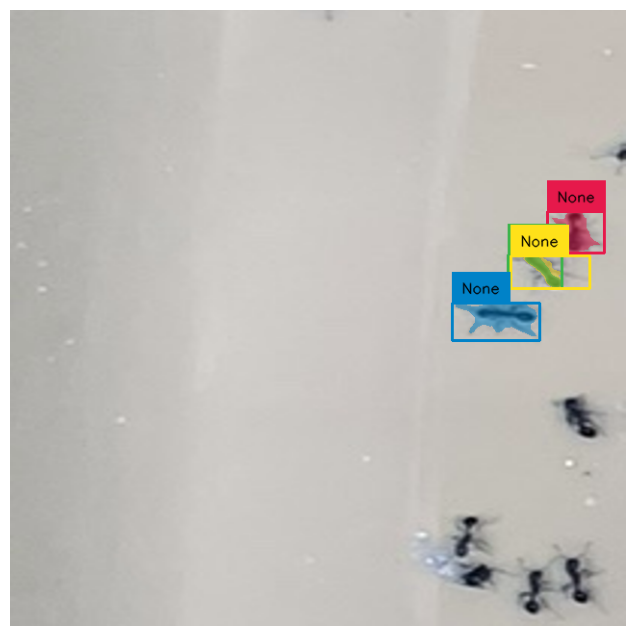

In [288]:
# annotate image with detections
box_annotator = sv.BoxAnnotator()
mask_annotator = sv.MaskAnnotator()
detection = sv.Detections(np.array(bbox))
detection.mask = sam_result
annotated_image = mask_annotator.annotate(scene=image.copy(),
                                          detections=detection)
annotated_image = box_annotator.annotate(scene=annotated_image,
                                         detections=detection)
sv.plot_image(annotated_image, (8, 8))

In [ ]:
detection.

## Native SAM (not good)

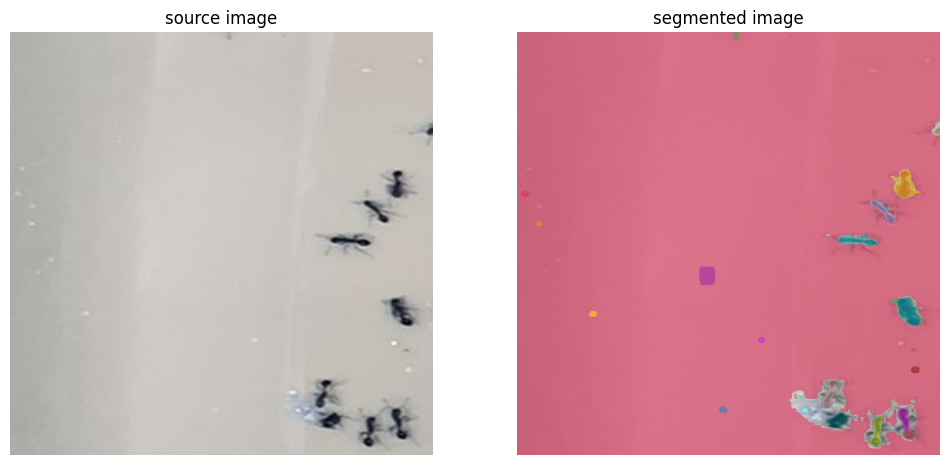

In [289]:
mask_generator = SamAutomaticMaskGenerator(sam)
sam_result = mask_generator.generate(image)
mask_annotator = sv.MaskAnnotator()
detections = sv.Detections.from_sam(sam_result=sam_result)
annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)

sv.plot_images_grid(
    images=[image, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)